<font size="7"><font color="blue"><center><b>TEAM 5PY ADDITIONAL ANALYSIS</b></font>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from datetime import datetime, date
import plotly.express as px
import imageio
from PIL import Image
from matplotlib.patches import Patch
import mplcyberpunk


In [2]:
df_Patients = pd.read_excel("HospitalDatabase.xlsx","Patients")
df_EDvisits = pd.read_excel("HospitalDatabase.xlsx","EDVisits")
df_AmbulatoryVisits = pd.read_excel("HospitalDatabase.xlsx","AmbulatoryVisits")
df_ReadmissionRegistry = pd.read_excel("HospitalDatabase.xlsx","ReAdmissionRegistry")
df_Discharges = pd.read_excel("HospitalDatabase.xlsx","Discharges")
df_Providers = pd.read_excel("HospitalDatabase.xlsx","Providers")
df_EDunique = pd.read_excel("HospitalDatabase.xlsx","EDUnique")

<font size="5"><b><u>81. Perform an Exploratory analysis of any 1 dataframe, using several methods </u></b></font><br>
<font size="2"> Inspired by: https://medium.com/towards-data-science/5-powerful-python-libraries-you-need-to-know-to-enhance-your-eda-process-f0100d563c16 </font>

<font size="4"><u><b>Step 81a. EDA using the Ydata Profiling Library </b></u></font>

In [ ]:
pip install ydata-profiling

<font size="2"><b><i>Scroll to see the full data report. You can also explore charts for different variables</i></font>

In [24]:
from ydata_profiling import ProfileReport
import warnings

warnings.filterwarnings("ignore")

ProfileReport(df_AmbulatoryVisits)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<font size="4"><u><b>Step 81b. EDA using the Dtale Profiling Library </b></u></font>

In [ ]:
pip install dtale

<font size="2"><font color="blue"><i><b>Dropdown menu can be used to visualize any analysis. We've chosen the Pearson correlation matrix. The saved image is in the same folder</b></i></font>

In [3]:
import dtale
dtale.show(df_AmbulatoryVisits)

<font size="4"><u><b>Step 81c. EDA using the MissingNo Library </b></u></font><br>
<font size="3"><i>Allows you to visualize correlations between incomplete data </i></font>



In [ ]:
pip install missingno

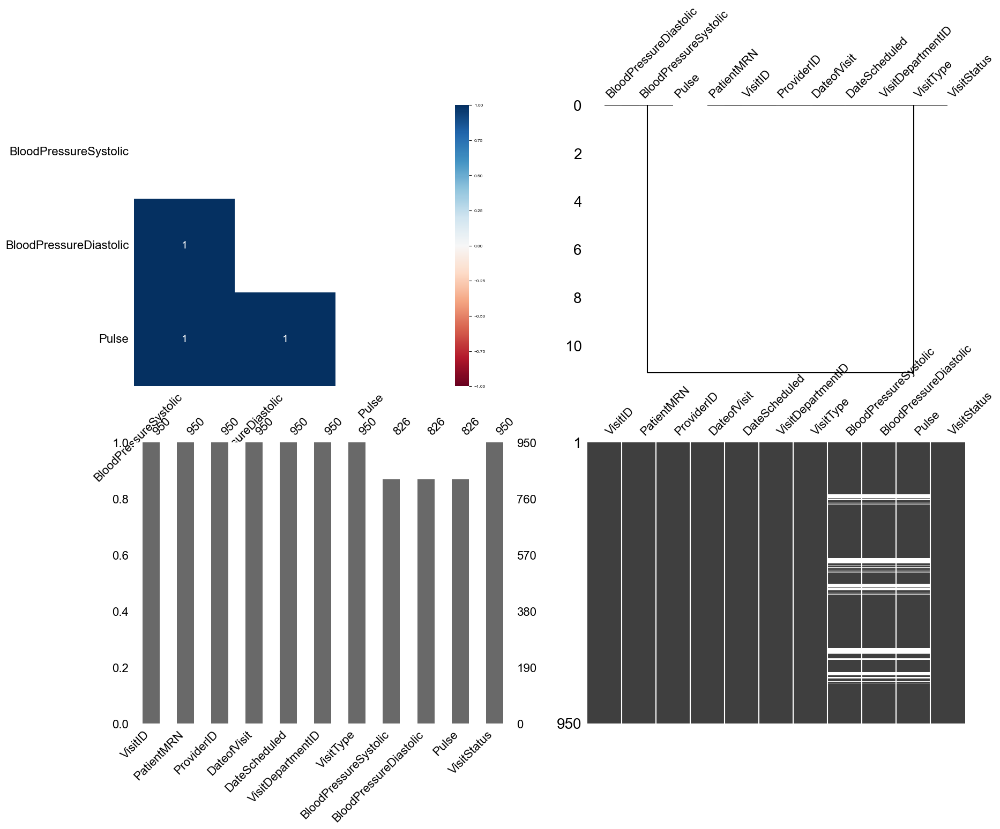

In [29]:
import missingno as msno

fig, axes = plt.subplots(2, 2, figsize=(20,15))

msno.heatmap(df_AmbulatoryVisits, ax=axes[0, 0])
msno.matrix(df_AmbulatoryVisits, ax=axes[1, 1])
msno.bar(df_AmbulatoryVisits, ax=axes[1, 0])
msno.dendrogram(df_AmbulatoryVisits, ax=axes[0, 1])



plt.rcParams['font.family'] = 'Arial'
plt.rcParams['font.size'] = 5
plt.rcParams['xtick.labelsize'] = 3 
plt.rcParams['ytick.labelsize'] = 6

plt.show()


<font size="5"><b><u>82. Create a Timelapse Visualization that shows the changing Age and Gender Distribution For Daily ED Visits</u></b></font><br>
<font size="2"> Inspired by: https://towardsdatascience.com/how-to-create-beautiful-age-distribution-graphs-with-seaborn-and-matplotlib-including-animation-68ebabff41bd </font>

<font size="3"><b>Step 82a. Drop all columns not related to Age or ED Visit Day and create functions to help break dates and age down to year and DOB respectively </b></font>

In [4]:
df_EDvisits=df_EDvisits.drop(columns=['EDVisitID','EDDischargeTime','Acuity','ReasonForVisit','EDDisposition'])

In [11]:
def age(DOB):
    DOB = datetime.strptime(DOB, "%Y-%m-%d").date()
    today = date.today()
    return today.year - DOB.year

def VisDay(VDay):
    VDay = datetime.strptime(VDay, "%Y-%m-%d").date()
    return VDay.day

def VisYear(VYear):
    VYear = datetime.strptime(VYear, "%Y-%m-%d").date()
    today = date.today()
    return VYear.year

<font size="3"><b> 82.b Group Patients by age ranges <b></font>

In [12]:
df_Patients['Date'] = ((pd.to_datetime(df_Patients['DateOfBirth']).dt.date).astype(str))
df_EDvisits['Date'] = ((pd.to_datetime(df_EDvisits['VisitDate']).dt.date).astype(str))
df_Patients['Age'] = df_Patients['Date'].apply(age)
df_EDvisits['Day'] = df_EDvisits['Date'].apply(VisDay)
df_EDvisits['Year'] = df_EDvisits['Date'].apply(VisYear)

df_Patients['AgeGroup'] = np.where(df_Patients['Age']<30, 'Under 30',
                   np.where(df_Patients['Age'].between(30,40) , '30-40',
                   np.where(df_Patients['Age'].between(40,50) , '40-50',
                   np.where(df_Patients['Age'].between(50,60) , '50-60','Over 60'))))

In [22]:
df_Visit_Patients= pd.merge(df_Patients,df_EDvisits, on = 'PatientID', how='inner').drop(columns=['FirstName','LastName','DateOfBirth','Race','Language'])
Grouped_df=df_Visit_Patients.groupby(['Gender','AgeGroup','Day','Year']).size().reset_index(name = 'Count')

<font size="3"><b> 82.c Clean data and separate them into male and female dataframes so that they can take up 2 sides of the axis</b> </font>

In [11]:
female_df=Grouped_df.query("Gender=='Female'")
male_df=Grouped_df.query("Gender=='Male'")

In [12]:
def create_age_distribution(female, male, Day):
    df_f = female[female_df.Day == Day].loc[::-1]
    df_m = male[male.Day == Day].loc[::-1]
    
    ax = sns.barplot(y=df_m["AgeGroup"], x=df_m["Count"]*-1, orient="h", color=MALE_COLOR)
    ax = sns.barplot(y=df_f["AgeGroup"], x=df_f["Count"], orient="h", color=FEMALE_COLOR)
    
    return ax

<font size="3"> <b>82.d Set up the style and color paletter <b></font>

In [13]:
def set_seaborn_style(font_family, background_color, grid_color, text_color):
    sns.set_style({
        "axes.facecolor": background_color,
        "figure.facecolor": background_color,

        "axes.labelcolor": text_color,

        "axes.edgecolor": grid_color,
        "axes.grid": True,
        "axes.axisbelow": True,

        "grid.color": grid_color,

        "font.family": font_family,
        "text.color": text_color,
        "xtick.color": text_color,
        "ytick.color": text_color,

        "xtick.bottom": False,
        "xtick.top": False,
        "ytick.left": False,
        "ytick.right": False,

        "axes.spines.left": False,
        "axes.spines.bottom": True,
        "axes.spines.right": False,
        "axes.spines.top": False,
    }
)

In [14]:
FEMALE_COLOR = "#F64740"
MALE_COLOR = "#05B2DC"

font_family="Serif"
background_color="#253D5B"
grid_color="#355882"
text_color="#EEEEEE"

set_seaborn_style(font_family, background_color, grid_color, text_color)


In [15]:
def add_legend(x, y): 
    patches = [
        Patch(color=MALE_COLOR, label="Male"),
        Patch(color=FEMALE_COLOR, label="Female")
    ]
    
    leg = plt.legend(
        handles=patches,
        bbox_to_anchor=(x, y), loc='center',
        ncol=2, fontsize=10,
        handlelength=1, handleheight=0.4,
        edgecolor=background_color
    )

In [16]:
def create_image_from_figure(fig):
    plt.tight_layout()
    
    fig.canvas.draw()
    data = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
    data = data.reshape((fig.canvas.get_width_height()[::-1]) + (3,))
    plt.close() 
    
    return Image.fromarray(data)

def add_padding_to_chart(chart, left, top, right, bottom, background):
    size = chart.size
    image = Image.new("RGB", (size[0] + left + right, size[1] + top + bottom), background)
    image.paste(chart, (left, top))
    return image

<font size="3"><b> 82.e Create the image grid that will then be converted to a time lapse gif </b></font>

In [17]:
def create_grid(figures, pad, ncols=5):
    nrows = len(figures) // ncols + 1  
    size = figures[0].size

    image = Image.new(
        "RGBA",
        (ncols * size[0] + (ncols - 1) * pad, nrows * size[1] + (nrows - 1) * pad),
        "#ffffff00"
    )

    for i, figure in enumerate(figures):
        col, row = i % ncols, i // ncols
        image.paste(figure, (col * (size[0] + pad), row * (size[1] + pad)))

    return image


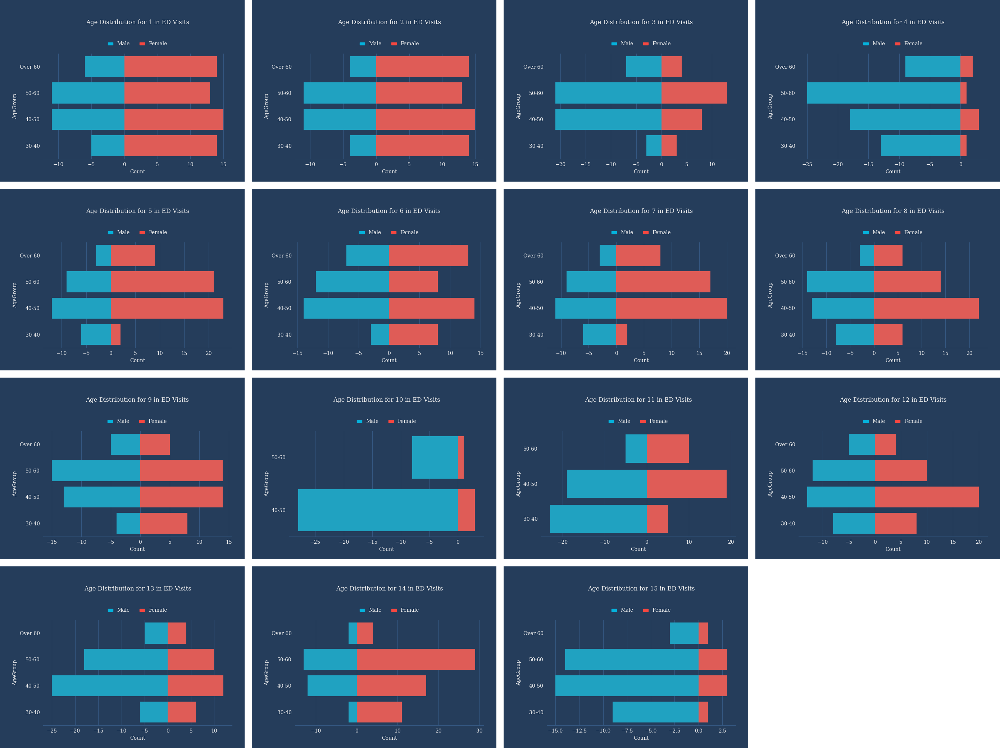

In [24]:
figures = []

for Day in [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]:
    fig = plt.figure() 
    ax = create_age_distribution(female=female_df, male=male_df, Day=Day)
    add_legend(x=0.5, y=1.09)
    plt.title("Age Distribution for {} in ED Visits".format(Day), y=1.25, fontsize=12)
    image = create_image_from_figure(fig)
    image = add_padding_to_chart(image, 20, 20, 20, 5, background_color)
    figures.append(image)

grid = create_grid(figures, pad=20, ncols=4)
grid

<font size="3"><b> 82.f Create the time lapse gif. The gif is saved in the same folder as time-lapse-age.gif. It can be viewed after download </b> </font>

In [23]:
images = []

for Day in [1, 2, 3, 4, 5, 6, 7,8,9,10,11,12,13,14,15]:
    ax = create_age_distribution(female=female_df, male=male_df, Day=Day)
    add_legend(x=0.5, y=1.09)
    plt.title("Age Distribution ED Visits On Day:", y=1.25, fontsize=12)
    plt.text(x=0.77, y=1.20, s=str(Day), fontsize=12, transform=ax.transAxes)
    image = create_image_from_figure(fig)
    image = add_padding_to_chart(image, 20, 20, 20, 5, background_color)
    images.append(image)
    
figures = figures + [figures[-1] for _ in range(7)]
imageio.mimwrite('./time-lapse-age.gif', figures, duration=0.45)

<font size="5"><u><b>83. Create a network graph that shows the providers listed under each type of specialty</b></u></font><br>
<font size="2"> Inspired By: https://towardsdatascience.com/building-interactive-network-graphs-using-pyvis-5b8e6e25cf64 </font>

<b>Install All libraries and upgrade matplot lib to help support interactive graphs</b>

In [3]:
from pyvis.network import Network
import networkx as nx
%matplotlib qt
import os
os.environ['PYTHONIOENCODING'] = 'UTF-8'

In [4]:
from pyvis.network import Network
import pandas as pd

In [ ]:
pip install --upgrade networkx

In [ ]:
pip install --upgrade matplotlib

In [5]:
import networkx as nx
%matplotlib inline

<font size ="3"><b>83.a Group providers and specialties. Drop all columns not related to the chart</b></font>

In [6]:
df_Providers=df_Providers.drop(columns=['ProviderDateOnStaff'])

df_Providers['ProviderName'] = df_Providers['ProviderName'].str.strip()
df_Providers['ProviderSpecialty'] = df_Providers['ProviderSpecialty'].apply(lambda x: x.encode('ascii', 'ignore').decode('ascii'))
df_Providers.head()

,ProviderID,ProviderName,ProviderSpecialty
0,1,Sally Sue,Pediatrics
1,2,Mike Myers,Pediatrics
2,3,Jordan Michael,Pediatrics
3,4,Ted Texas,Pediatrics
4,5,Ala Bama,Pediatrics


<font size="3"><b> 83.b Option 1: Build a simple network graph </b></font>

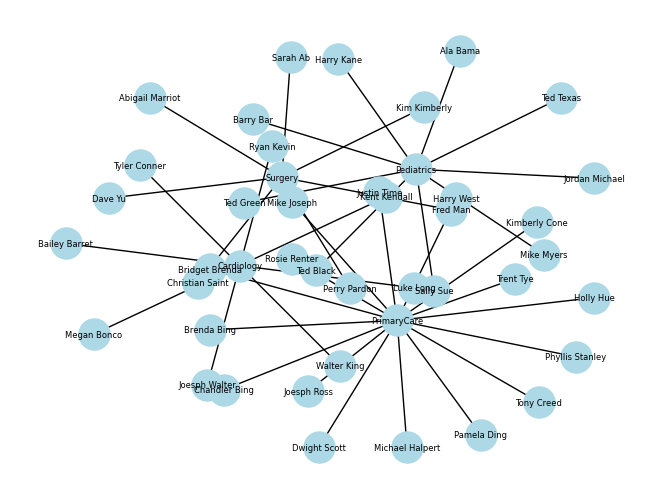

<Figure size 1500x1000 with 0 Axes>

In [7]:
df_Providers['ProviderName'] = df_Providers['ProviderName'].str.strip()
G = nx.Graph()

specialties = set(df_Providers['ProviderSpecialty'])

# Add nodes
for specialty in specialties:
    G.add_node(specialty)

for _, _, provider_name, specialty in df_Providers.itertuples():
    G.add_node(provider_name)

# Add edges 
for _, _, provider_name, specialty in df_Providers.itertuples():
    G.add_edge(provider_name, specialty)

pos = nx.kamada_kawai_layout(G)


nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500, font_size=6, font_color='black')

plt.figure(figsize=(15, 10))

plt.show()


<i><b><font color="red">The spacing on a non-interactive graph will need to be adjusted manually. So option 2 might work better</font></b></i>

<font size="3"><b> 83.c Option 2: Build an interactive network graph using html </b></font><br>

In [32]:
net = Network(
    notebook = True,
    directed = True,            
    bgcolor = "black",           
    font_color = "yellow",
    cdn_resources = 'remote',  
    height = "1000px",          
    width = "100%"             
    )

specialties = set(df_Providers['ProviderSpecialty'])

for specialty in specialties:
    net.add_node(specialty,size=50,font_size=20)

# Add nodes 
for _, provider_id, provider_name, specialty in df_Providers.itertuples():
    net.add_node(provider_name,size=40,font_size=18)

# Add edges
for _, provider_id, provider_name, specialty in df_Providers.itertuples():
    net.add_edge(provider_name, specialty)

In [35]:
net.repulsion(
    node_distance=150,
    spring_length=200,
    spring_strength=0.05,
    damping=0.09,
)

<i><font color="blue"><b>The G.html file in the same folder can be viewed in a browser for a clearer picture</font></i>

In [36]:
net.show("g.html")

g.html


<font size="5"><b><u> 84. Using a Radar Chart, show the relationship between ICULOS, Age and Service</u></b></font><br>
<font size="2"> Inspired by https://medium.com/towards-data-science/creating-an-infographic-with-matplotlib-3c5ece11bedc </font>

<font size="3"><b> 84.a Create a dataframe with only the columns needed and group as required </b></font>

In [92]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [82]:
df_Service= pd.merge(df_ReadmissionRegistry,df_Patients, on = 'PatientID', how='inner').drop(columns=['AdmissionID','AdmissionDate','DischargeDate','DischargeDisposition','ReadmissionFlag','DaysToReadmission','EDVisitAfterDischargeFlag','FirstName','LastName','DateOfBirth','PrimaryDiagnosis','PatientID','Age','Gender','Race','Language','Date','ExpectedMortality'])
df_Service.head(4)

,Service,ExpectedLOS,AgeGroup
0,Hospitalist,6.717771,Over 60
1,General Medicine,3.825969,30-40
2,General Medicine,3.382493,40-50
3,General Medicine,3.763352,Over 60


<font size="3"><b>84.b Create a Pivot Table for each age group with ICULOS values under service </b></font>

In [76]:
df_Pivot_service = df_Service.pivot_table(index='AgeGroup', columns='Service', values='ExpectedLOS', aggfunc='mean')
df_Pivot_service.reset_index(inplace=True)
df_Pivot_service.columns.name = None
df_Pivot_service.head(3)

,AgeGroup,Cardiology,General Medicine,Hospitalist,ICU,Neurology,Orthopeadics
0,30-40,12.068633,5.721956,7.752384,12.073831,11.247654,4.017605
1,40-50,12.276836,6.253390,7.063791,13.314643,10.553679,3.288035
2,50-60,11.968259,6.232746,8.636033,12.545177,11.808114,3.976561


<font size="3"><b>84.c Create a 2x2 grid for the 4 age groups</b></font><br>
<i> The differences between the various numbers are small so the graphs look similar. However, the labels do allow you to see that Age Range Over 60 and General Medicine have the highest ICULOS<i>

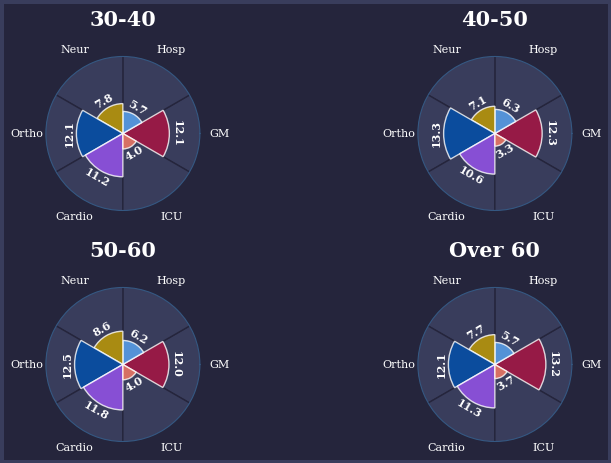

In [131]:
num_cols = 2

num_services = len(df_Pivot_service.columns) - 1

num_rows = np.ceil(num_services / num_cols).astype(int)
age_groups = df_Pivot_service['AgeGroup'].tolist() 

indexes = list(range(0, 6))
width = 2*np.pi / 6
angles = np.linspace(0, 2 * np.pi, num_services, endpoint=False)

colours = ["#ae1241", "#5ba8f7", "#c6a000", "#0050ae", "#9b54f3", "#ff7d67", "#dbc227", "#008c5c"]

label_loc = np.linspace(start=0, stop=2 * np.pi, num=6)


fig2 = plt.figure(figsize=(8,8), linewidth=5, edgecolor='#393d5c', facecolor='#25253c')
grid2 = plt.GridSpec(num_rows, num_cols, wspace=0.5, hspace=0.5)


sernames={'GM','ICU','Cardio','Hosp','Neur','Ortho'}



for i, (index, row) in enumerate(df_Pivot_service.iterrows()):
    ax = fig2.add_subplot(grid2[i // num_cols, i % num_cols], projection='polar')
    values = row.values[1:]

    bars = ax.bar(x=angles, height=row.values[1:], width=width,
                  edgecolor='white', zorder=2, alpha=0.8, color=colours)  # Use the 'colours' list for colors

    bars_bg = ax.bar(x=angles, height=50, width=width, color='#393d5c',
                     edgecolor='#25253c', zorder=1)
    
    ax.set_title(age_groups[index], pad=22, fontsize=15, fontweight='bold', color='white')
    ax.set_ylim(0, 20)
    ax.set_yticklabels([])
    ax.set_xticks([])
    ax.grid(color='#25253c')  
    for angle, height, ser_names in zip(angles, row.values[1:], sernames):  
        rotation_angle = np.degrees(angle)
        if angle < np.pi:
            rotation_angle -= 90
        elif angle == np.pi:
            rotation_angle -= 90
        else:
            rotation_angle += 90
        rounded_height = round(height, 1)
        ax.text(angle, height + 2, str(rounded_height),  
                ha='center', va='center', 
                rotation=rotation_angle, rotation_mode='anchor', fontsize=8, 
                fontweight='bold', color='white')
        tick_labels = [f'{ser_name}' for angle, ser_name in zip(np.degrees(angles), sernames)]
        ax.set_xticks(angles)
        ax.set_xticklabels(tick_labels, fontsize=8, color='white', rotation=90)  


<font size="5"><b><u>85. Create a Waffle chart to show what percentage of total visits belong to each primary diagnosis</u></b></font> <br> 
<font size="2"> Inspired by: https://medium.com/towards-data-science/how-to-create-beautiful-waffle-charts-for-data-visualisation-in-python-e9760a3f8594 </font>

<font size="3"><b> 85.a Import/install all relevant libraries and create the datafram with just the values needed</b></font>

In [ ]:
pip install pywaffle

In [12]:
from pywaffle import Waffle

In [13]:
df_diagnosis = df_ReadmissionRegistry['PrimaryDiagnosis'].value_counts().reset_index()
df_diagnosis = df_diagnosis.rename(columns={'index': 'Diagnosis', 'PrimaryDiagnosis': 'Count'})
df_diagnosis.head()

,Diagnosis,Count
0,Pneumonia,177
1,Flu,80
2,Heart Failure,78
3,Stroke,68
4,Diabetes,64


In [14]:
df_diagnosis = df_ReadmissionRegistry['PrimaryDiagnosis'].value_counts().reset_index()
df_diagnosis = df_diagnosis.rename(columns={'index': 'Diagnosis', 'PrimaryDiagnosis': 'Count'})
df_diagnosis['Percent'] = round(((df_diagnosis['Count'] / 720) * 100),2)
max_percent_diagnosis = df_diagnosis['Diagnosis'][df_diagnosis['Percent'].idxmax()]


<font size="3"><b>85b. Choose the colors and create the waffle chart</b></font>

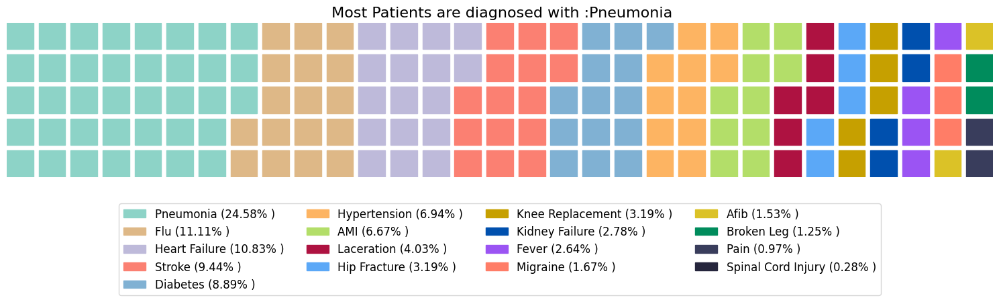

In [15]:
Wafflecolours = ['#8dd3c7', '#deb887', '#bebada', '#fb8072', '#80b1d3', '#fdb462', 
                 '#b3de69',"#ae1241", "#5ba8f7", "#c6a000", "#0050ae", "#9b54f3", 
                 "#ff7d67", "#dbc227", "#008c5c",'#393d5c', '#25253c']

plot_labels = [f'{i} ({str(j)}% )' for i,j in zip(df_diagnosis.Diagnosis,df_diagnosis.Percent)]

plt.figure(FigureClass=Waffle, figsize=(15,15), rows=5, columns = 31, 
                 values=list(df_diagnosis['Percent']),
                 colors=Wafflecolours,
                 labels=plot_labels, 
                 legend={'loc':'lower center', 'bbox_to_anchor': (0.5, -0.8), 
                        'ncol':4, 'fontsize':12},starting_location='NW')
plt.title(f' Most Patients are diagnosed with :{max_percent_diagnosis}', fontsize=16)
plt.show()

<font size=5><b><u>86. Create an interactive histogram showing distribution of patients by age. Including tooltips that show patient count by bin</u></b></font>

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
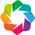

:Histogram   [Age]   (Age_count)

In [14]:
import hvplot.pandas
import holoviews as hv

HistColrs = ['#FF5733', '#3366FF']

normal_plot = df_Patients.hvplot.hist('Age', bins=15, title='Patient Count by Age', xlabel='Age', ylabel='Patient Count', color='navy')
hv.extension('bokeh')

normal_plot

<font size=5><b><u>87. Prove or disprove the existence of a relationship between Diastolic Blood Pressure and ICU visits in the given datset</u></b></font>

<font size=3><i> To solve this, we decided to use the linear regression formula and create a scatter plot of patients and their DBP </i></font>

In [ ]:
pip install scikit-learn

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.impute import SimpleImputer

In [ ]:
df_Pulse= pd.merge(df_AmbulatoryVisits,df_Discharges, left_on='PatientMRN', right_on='PatientID', how='inner').drop(columns=['AdmissionID','AdmissionDate','DischargeDate','DischargeDisposition','PatientMRN','ProviderID','DateofVisit','DateScheduled','VisitDepartmentID','VisitType','VisitStatus'])
df_Pulse_ICU=df_Pulse[df_Pulse['Service'] == 'ICU']
df_Pulse_ICU.dropna(subset=['BloodPressureDiastolic'], inplace=True)

imputer = SimpleImputer(strategy='mean')  
df_Pulse_ICU['BloodPressureDiastolic'] = imputer.fit_transform(df_Pulse_ICU['BloodPressureDiastolic'].values.reshape(-1, 1))
x = df_Pulse_ICU['PatientID'].values.reshape(-1, 1)
y = df_Pulse_ICU['BloodPressureDiastolic']

linear_regressor = LinearRegression() 
linear_regressor.fit(x, y)  
Y_pred = linear_regressor.predict(x)
p_value = linear_regressor.score(x, y)

<font size=2><font color="blue"><b> We can see from the chart below that there is no relationship between the variables given (in the data available to us)</font>

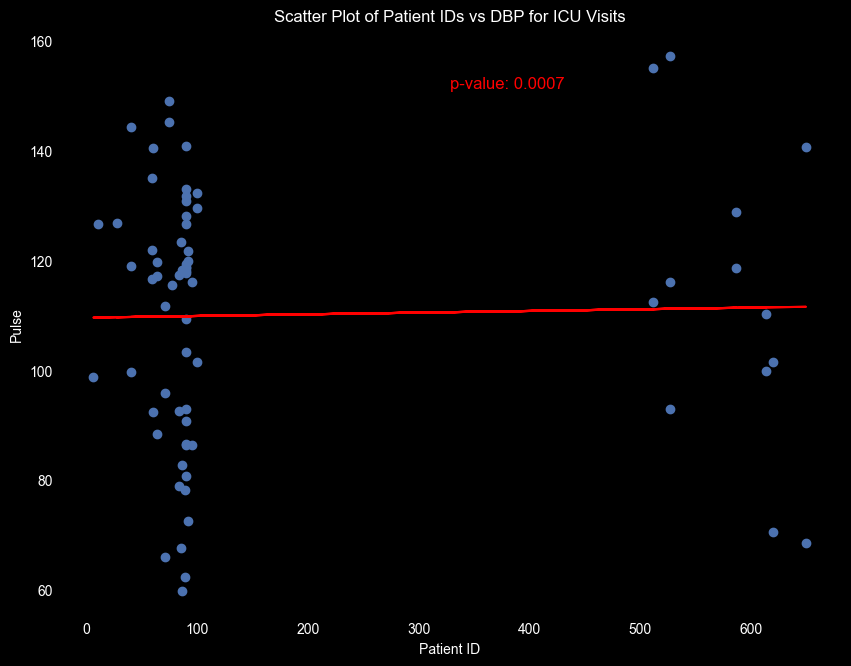

In [27]:
from qbstyles import mpl_style

plt.figure(figsize=(8, 6))
plt.scatter(x, y, marker='o', alpha=1)
plt.plot(x, Y_pred,c="red")
plt.text(0.5, 0.9, f'p-value: {p_value:.4f}', transform=plt.gca().transAxes, color='red',fontsize=12)
plt.title('Scatter Plot of Patient IDs vs DBP for ICU Visits')
plt.xlabel('Patient ID')
plt.ylabel('Pulse')
plt.style.use('seaborn-v0_8-dark-palette')
plt.show()

<font size=5><b><u>88. Attempt to build a predictive model for Organ failure, based on the heart health metrics in the data given</u></b></font><br>
Inspired by: https://medium.com/@rmadhu2131/diagnosing-gestational-diabetics-using-ml-b8a763ce1d79

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from imblearn import under_sampling, over_sampling
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler

In [52]:
df_Vitals= pd.merge(df_AmbulatoryVisits,df_ReadmissionRegistry, left_on='PatientMRN', right_on='PatientID', how='inner').drop(columns=['ProviderID','DateofVisit','DateScheduled','VisitDepartmentID','VisitType','VisitStatus','AdmissionID','AdmissionDate','DischargeDate','DischargeDisposition','Service','ReadmissionFlag','DaysToReadmission','EDVisitAfterDischargeFlag','VisitID'])

In [53]:
df_Vitals['Organ Failure'] = np.where(
    (df_Vitals['PrimaryDiagnosis'] == 'Heart Failure') | (df_Vitals['PrimaryDiagnosis'] == 'Afib')|
    (df_Vitals['PrimaryDiagnosis'] == 'Kidney Failure')|(df_Vitals['PrimaryDiagnosis'] == 'AMI')
    |(df_Vitals['PrimaryDiagnosis'] == 'Hypertension')|(df_Vitals['PrimaryDiagnosis'] == 'Stroke'), 1, 0)
df_Vitals.dropna(subset=['BloodPressureDiastolic'], inplace=True)
df_Vitals.dropna(subset=['BloodPressureSystolic'], inplace=True)
df_Vitals.dropna(subset=['Pulse'], inplace=True)

df_Vitals.drop(columns=['PrimaryDiagnosis','PatientID','PatientMRN','ExpectedLOS','ExpectedMortality'],inplace=True)

In [54]:
num_rows_to_drop = df_Vitals[df_Vitals['Organ Failure'] == 0].shape[0] // 3
df_Vitals_balanced = pd.concat([
    df_Vitals[df_Vitals['Organ Failure'] == 0].sample(n=num_rows_to_drop, random_state=0),
    df_Vitals[df_Vitals['Organ Failure'] == 1]
])

<font color="blue"><font size="3"> 

<font size=2><font color="blue"><b> Due to the differences in the size of data, we used very aggressive undersampling to match the 2 datasets. We managed to relate heart health to oragn related complications with a 67% accuracy. However to accurately stand by this data, a larger population sample is necessary</font>

In [73]:
X = df_Vitals_balanced[['Pulse', 'BloodPressureDiastolic','BloodPressureSystolic']]
y = df_Vitals_balanced['Organ Failure']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=0)


undersampler = RandomUnderSampler(sampling_strategy=1,random_state=0)  
X_train_resampled, y_train_resampled = undersampler.fit_resample(X_train, y_train)

model = LogisticRegression()
model.fit(X_train_resampled, y_train_resampled)

y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.40      0.53      0.46        15
           1       0.67      0.54      0.60        26

    accuracy                           0.54        41
   macro avg       0.53      0.54      0.53        41
weighted avg       0.57      0.54      0.55        41



<font size=5><b><u>89.Create a sankey diagram showing the flow of Providers to Provider Specialties by Patient Visits</u></b></font><br>
Inspired by: https://medium.com/analytics-vidhya/how-to-do-a-sankey-plot-in-python-5298869f5e8e

In [ ]:
pip install webcolors

<font size="3"><b> 89.a Import libraries and retain only Provider Name, Specialty and number of visits</b></font>

In [59]:
from webcolors import hex_to_rgb
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


df_ProvidersSpec=df_Providers.drop(columns=['ProviderDateOnStaff'])

df_ProvidersSpec['ProviderName'] = df_ProvidersSpec['ProviderName'].str.strip()
df_ProvidersSpec['ProviderSpecialty'] = df_ProvidersSpec['ProviderSpecialty'].apply(lambda x: x.encode('ascii', 'ignore').decode('ascii'))

df_Amb= pd.read_excel("HospitalDatabase.xlsx","AmbulatoryVisits")
df_Amb=df_Amb.drop(columns=['PatientMRN','DateofVisit','DateScheduled','VisitDepartmentID','BloodPressureSystolic','BloodPressureDiastolic','Pulse','VisitStatus'])

df_SpecVisits=pd.merge(df_Amb,df_ProvidersSpec, on = 'ProviderID', how='left')
    
df_SpecVisits.drop(columns=['VisitID', 'ProviderID', 'VisitType'], inplace=True)

df_VisitCounts = df_SpecVisits.groupby(['ProviderName', 'ProviderSpecialty']).size().reset_index(name='VisitCount')

<font size="3"><b> 89.b Assign values to lists</b></font>

In [60]:
provider_names = df_VisitCounts['ProviderName'].tolist()
specialties = df_VisitCounts['ProviderSpecialty'].tolist()
node_dict = {name: idx for idx, name in enumerate(provider_names + specialties)}

source = df_VisitCounts['ProviderSpecialty'].tolist()
target = df_VisitCounts['ProviderName'].tolist()
values = df_VisitCounts['VisitCount'].tolist()

<font size="3"><b> 89.a Plot the Sankey from source to target</b></font><br>
<font color="blue"><b> The sankey diagram is best viewed as a .png file saved in the same folder. The true size and spacing cannot be viewd inside Jupyter

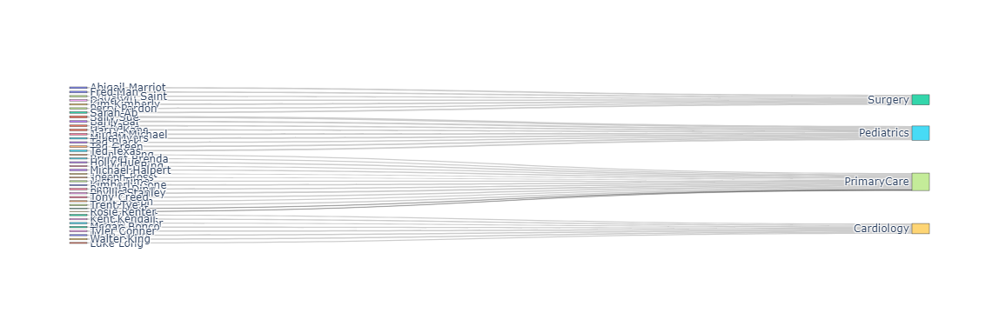

In [58]:
import plotly.graph_objects as go
from plotly.offline import plot

fig = go.Figure(
    data=[go.Sankey(
        node=dict(
            label=provider_names + specialties
        ),
        link=dict(
            source=[node_dict[target] for target in target],
            target=[node_dict[source] for source in source],
            value=values
        ))])

# Save the plot
plot(fig,
     image_filename='sankey_plot_1',
     image='png',
     image_width=1000,
     image_height=1500
)

# Show the plot
fig.show()


<font size=5><b><u>90.Create a chord diagram that shows the relationship between primary diagnosis and services rendered</u></b></font><br>
Inspired by: https://medium.com/towards-data-science/plotting-chord-diagrams-in-python-72fd71b3

In [3]:
import holoviews as hv

In [4]:
df_ServDiagnosis=df_ReadmissionRegistry.drop(columns=['AdmissionID','PatientID','AdmissionDate','DischargeDate','ExpectedLOS','ExpectedMortality','ReadmissionFlag','DaysToReadmission','EDVisitAfterDischargeFlag','DischargeDisposition'])
df_ServDiagnosis1 = df_ServDiagnosis.groupby([ 'Service','PrimaryDiagnosis']).size().reset_index(name='ServiceCount')

Services = list(set(df_ServDiagnosis1["Service"].unique().tolist() + 
                    df_ServDiagnosis1["PrimaryDiagnosis"].unique().tolist()))

Services_dataset = hv.Dataset(pd.DataFrame(Services, columns=["Service"]))

<font color="blue"><b>The chord diagram is interactive, You can click on various services and see how they connect to each other, the ones that connect them are the number of patients re-admitted</b></font>

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
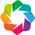

:Chord   [Service,PrimaryDiagnosis]   (ServiceCount)

In [14]:
hv.extension('bokeh')
chord = hv.Chord((df_ServDiagnosis1, Services_dataset))
chord.opts(
    height=620, width=1100, title="Services rendered by primary Diagnosis",
    node_color="Service", node_cmap="Category20", edge_color="PrimaryDiagnosis", edge_cmap='Bokeh',
    label_index='Service', label_text_font_size='9pt',bgcolor='black', label_text_color='white'
)

<font size=5><b><u>91.Create a grouped bar chart that shows number of patients by race and gender</u></b></font><br>
Inspired by: https://medium.com/analytics-vidhya/create-a-grouped-bar-chart-with-matplotlib-and-pandas-9b021c97e0a

In [9]:
import matplotx
import matplotx.styles

In [4]:
df_PatientsGroup=df_Patients.drop(columns=['PatientID','FirstName','LastName','DateOfBirth'])

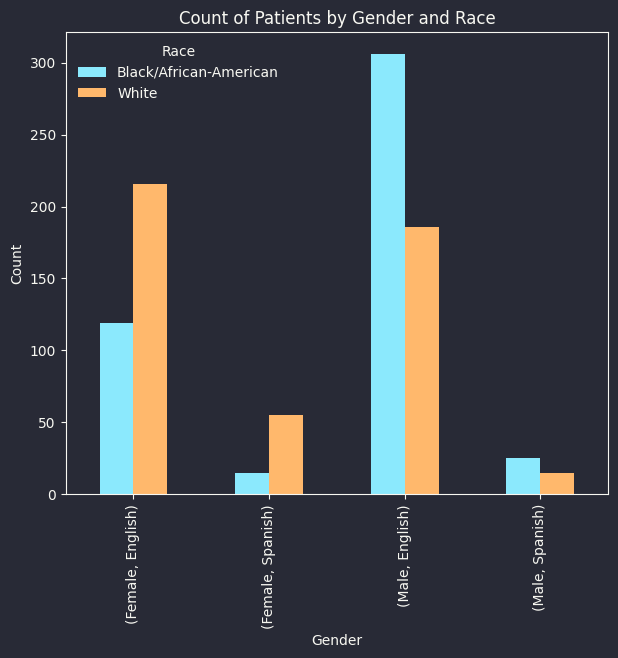

In [10]:
df_CrossTab = pd.crosstab(index=[df_PatientsGroup['Gender'], df_PatientsGroup['Language']],columns=df_PatientsGroup['Race'])


with plt.style.context(matplotx.styles.dracula):
    fig, ax = plt.subplots(figsize=(7, 6)) 
    df_CrossTab.plot(kind="bar", ax=ax)  
    ax.set_xlabel("Gender")
    ax.set_ylabel("Count")
    ax.set_title("Count of Patients by Gender and Race")

plt.show()